In [46]:
# mounring drive
from google.colab import drive
drive.mount('/content/drive')

# installing *padas-profilin* from github
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip --quiet

!pip install --upgrade keras-cv --quiet
!pip install --upgrade keras --quiet
!pip install --upgrade tensorflow --quiet

# !pip install -q --upgrade git+https://github.com/keras-team/keras-cv tensorflow pycocotools seaborn --quiet

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
  Preparing metadata (setup.py) ... done


In [47]:
# !pip install --upgrade tensorflow==2.0.0-alpha0 --quiet

In [48]:
# !pip install --upgrade python==3.7 --quiet

In [49]:
# # install 2.0.0-alpha0 version of tensoflow
# !pip install tensorflow==2.0.0-alpha0

In [50]:
# imports
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport
import os
from pathlib import Path
import shutil
from PIL import Image

import os

os.environ["KERAS_BACKEND"] = "jax"  # @param ["tensorflow", "jax", "torch"]

import json
import math
import numpy as np

import keras
from keras import losses
from keras import ops
from keras import optimizers
# from keras.optimizers import schedules
from keras import metrics

import keras_cv
from keras_cv import visualization

# Import tensorflow for [`tf.data`](https://www.tensorflow.org/api_docs/python/tf/data) and its preprocessing functions
import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import data as tf_data

import datetime

print(keras.__version__)
print(keras_cv.__version__)

3.5.0
0.9.0


In [51]:
def find(dir_, str):
  for each in dir(dir_):
    if str in each:
      print(each)

In [52]:
#@title loading data from mounted drive
train_ = pd.read_csv('/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/Train-Data.csv')
test_ = pd.read_csv('/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/Test-Data.csv')

In [53]:
#@title statestical analysis

# profile = ProfileReport(train_)
# profile.to_file(output_file='training_profiling.html')
# # profile = ProfileReport(test_)
# # profile.to_file(output_file='testing_profiling.html')

In [54]:
#@title Moving all images of all query to one folder - all_images

def move_images(to_, from_):
  # create destination folder
  destination_folder = to_
  # delete destination folder if it exist
  if os.path.exists(destination_folder):
    shutil.rmtree(destination_folder)
  # create destination folder
  os.makedirs(destination_folder)

  for i in Path(from_).iterdir():
    for _ in i.iterdir():  # i.iterdir() is iterating over all directories in "Image-Files"
      path = _    # _ = /content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/Image-Files/street litter/5452da10-679d-11e5-90f4-40f2e96c8ad8.jpg
      filename = os.path.basename(path)

      source_path = path
      destination_path = os.path.join(destination_folder, filename)
      shutil.copy(source_path, destination_folder)

to_ = '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/all_images'
from_ = '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/Image-Files/'
move_images(to_, from_)

In [55]:
#@title generalizing the type of image - for that finding the total unique image extentions present
def find_extentions(path):      # finds the number of different extentions are there in the given directory
  extentions = {}
  for i in Path(path).iterdir():
    if i.suffix not in extentions:
      extentions[i.suffix] = 1
    else:
      extentions[i.suffix] += 1
  # sum of value of each key
  print(sum(extentions.values()))
  return extentions

path = '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/all_images'
find_extentions(path)

907


{'.jpg': 833,
 '.jpeg': 5,
 '.JPG': 42,
 '.gif': 9,
 '.png': 16,
 '.JPEG': 1,
 '.php': 1}

In [56]:
#@title generalizing the type of image - deleting .php file & convering others to .jpg

def rename_files(path): # deletes .php files and remaning every other.
  for i in Path(path).iterdir():
    suffix = i.suffix # suffix = file extention i.e. ".jpg"
    without_extention = os.path.splitext(i)[0]
    # withoug_extention = # /content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/
    # all_images/5452da10-679d-11e5-90f4-40f2e96c8ad8

    if len(os.path.splitext(without_extention)) >=2:            # if there are morethan 1 "." the os.path.splitext()[0] takes only first part before the dot and adds the suffix in the end.
      os.rename(i, os.path.splitext(without_extention)[0]+suffix)  # to remove and generalize the name of the image for next step of moving data as per the labels

    if suffix == '.jpg':
      pass
    elif suffix == '.jpeg' or suffix == '.JPG' or suffix == '.JPEG':
      os.rename(i, without_extention+'.jpg')
    elif suffix == '.png':
      png_image = Image.open(i)
      # converting .png to .jpg using PLI library
      rgb_image = png_image.convert("RGB")

      # Save the image as a JPEG
      rgb_image.save(without_extention+'.jpg', quality=95)
      # remove/delete file
      os.remove(i)
    elif suffix == '.gif':
      gif_image = Image.open(i)
      # converting .gif to .jpg using PLI library and saving in '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/all_images' folder
      rgb_image = gif_image.convert("RGB")

      # Save the image as a JPEG
      rgb_image.save(without_extention+'.jpg', quality=95)
      # remove/delete file
      os.remove(i)
    else:                                     # .php files
      # remove/delete file
      os.remove(i)

path = '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/all_images'
rename_files(path)

In [57]:
#@title generalizing the type of image - final check that all the images in *all_images* folder is of *.jpg* type
#@markdown there are 906 files because the *.php* file is removed.

path = '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/all_images'
find_extentions(path)

906


{'.jpg': 906}

# change

In [58]:
# prompt: make csv for train and test dataset & add ImageID,Source,LabelName,Confidence,XMin,XMax,YMin,YMax,IsOccluded,IsTruncated,IsGroupOf,IsDepiction,IsInside columns

import pandas as pd




In [59]:
train_.head()

,image,query,label,startX,startY,endX,endY
0,398faec8-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,18.0,113.0,528.0,427.0
1,3adba2c8-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,NaN,NaN,NaN,NaN,NaN
2,46e3e5ee-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,188.0,183.0,553.0,401.0
3,47e1b9a8-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,NaN,NaN,NaN,NaN,NaN
4,495f1dca-6799-11e5-8dc4-40f2e96c8ad8.jpg,city garbage,1.0,270.0,306.0,369.0,340.0


In [60]:
#@title movind the image data according to their labels
#markdown In this approach I am considering the all *none* labelled images as *0* labelled.

def find_labels(dataFrame_):
  label_1=[]
  label_0=[]

  for each in dataFrame_.iterrows():

    filename = Path(each[1].image)
    without_extention = os.path.splitext(filename)[0]

    if filename.suffix == '.php':                   # don't add .php file, because we have removed it.
      continue

    if each[1].label == 1:
      label_1.append(without_extention+'.jpg')
    else:
      label_0.append(without_extention+'.jpg')

  print(len(label_1))
  print(len(label_0))
  print(f'sum = {len(label_1) + len(label_0)}')      # the sum should be 906

  return label_1, label_0

In [61]:
#@title making openimage annotation

# make csv that has following columns : ImageID,Source,LabelName,Confidence,XMin,XMax,YMin,YMax,IsOccluded,IsTruncated,IsGroupOf,IsDepiction,IsInside

def make_annotation(dataFrame_, save_path):

  # creating a dataframe for train and test dataset
  df_annotation = pd.DataFrame(columns=['ImageID','Source','LabelName','Confidence','XMin','XMax','YMin','YMax','IsOccluded','IsTruncated','IsGroupOf','IsDepiction','IsInside'])

  # filling the dataframe with the data from the csv file
  row=0                                             # adding row counter along with iteration over len(dataFrame_), because we are deleting .php file and that will increment i but won't add any row in data frame and for the next i it will add row, so there may be an enpty row in dataframe, and to overcome that I have added a new increment which won't increment while deleting file for .php / not adding row for .php
  for i in range(len(dataFrame_)):
    filename = Path(dataFrame_.iloc[i]['image'])
    without_extention = os.path.splitext(filename)[0]

    if filename.suffix == '.php':                   # don't add .php file, because we have removed it.
      # row+=1                                      # not incrementing
      continue

    updated_filename = without_extention+'.jpg'

    if dataFrame_.iloc[i]['label'] == 1:
      label = 'waste'
    else:
      continue

    # adding the data to the dataframe
    df_annotation.loc[row] = [updated_filename,'', label,'', dataFrame_.iloc[i]['startX'], dataFrame_.iloc[i]['endX'], dataFrame_.iloc[i]['startY'], dataFrame_.iloc[i]['endY'],'','','','','' ]
    row+=1                                          # incrementing row counter

  # saving the dataframe to csv file
  df_annotation.to_csv(save_path, index=False)


make_annotation(train_, '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/localization/train_annotation.csv')
make_annotation(test_, '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/localization/test_annotation.csv')


In [62]:
# put all images with image id in list "label_1" in folder label-1 and list "label_0" in label-0 folder from this folder - '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/Image-Files'

def move_images_as_per_labels(source_folder, destination_folder_1, destination_folder_0, label_1, label_0):

  # delete them if they already exist & Create destination folders if they don't exist
  if os.path.exists(destination_folder_1):
    shutil.rmtree(destination_folder_1)
  if os.path.exists(destination_folder_0):
    shutil.rmtree(destination_folder_0)
  os.makedirs(destination_folder_1, exist_ok=True)
  os.makedirs(destination_folder_0, exist_ok=True)

  # Move files for label 1
  for image_id in label_1:
    filename = image_id   # Assuming images are in JPG format
    source_path = os.path.join(source_folder, filename)
    destination_path = os.path.join(destination_folder_1, filename)
    shutil.copy(source_path, destination_path)

  # Move files for label 0
  for image_id in label_0:
    filename = image_id  # Assuming images are in JPG format
    source_path = os.path.join(source_folder, filename)
    destination_path = os.path.join(destination_folder_0, filename)
    shutil.copy(source_path, destination_path)

# loading data

In [63]:

table = {}
class_mapping = {}
counter = 0

def lut(label):
    global counter
    if label in table:
        return table[label]
    counter += 1
    table[label] = counter
    class_mapping[counter] = label
    return table[label]


In [64]:
bounding_box_format = 'center_xywh'
BATCH_SIZE = 8

In [65]:
splits = {
    'train': '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/localization/training.v1i.createml/train/',
    'test': '/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/localization/testing_data.v1i.createml/test',
    'validation': 'data/valid'
}

def load_image(filepath):
  image_data = tf.io.read_file(filepath)
  return tf.cast(tf.io.decode_jpeg(image_data, channels=3), tf.float32)

def load(*, split, bounding_box_format):
  if not split in splits:
    raise ValueError(
        f"Invalid split provided, `split={split}`. "
        f"Expected one of {list(splits.keys())}"
    )

  path = splits[split]
  with open(f'{path}/_annotations.createml.json', 'r') as f:
    file_annotations = json.load(f)

  def generator():
    for entry in file_annotations:
      annotations = entry['annotations']
      image_path = entry['image']

      box_labels = []
      class_labels = []

      for annotation in annotations:
        box = annotation['coordinates']
        box = tf.constant(
            [box['x'], box['y'], box['width'], box['height']], tf.float32
        )
        box_labels.append(
          box
        )
        class_labels.append(
            tf.constant(lut(annotation['label']), tf.float32)
        )

      if len(box_labels) == 0:
        continue

      bounding_boxes = {
          'boxes': tf.stack(box_labels),
          'classes': tf.stack(class_labels)
      }
      image = load_image(f"{path}/{image_path}")
      bounding_boxes = keras_cv.bounding_box.convert_format(bounding_boxes, source ='center_xywh', target=bounding_box_format)
      yield {
          'images': image,
          'bounding_boxes': bounding_boxes
      }

  output_spec = {
    'images': tf.TensorSpec(shape=(None, None, 3)),
    'bounding_boxes': {
        'boxes': tf.TensorSpec(shape=(None, 4)),
        'classes': tf.TensorSpec(shape=(None,))
    }
  }
  return tf.data.Dataset.from_generator(generator, output_signature=output_spec)

In [66]:
train_ds = load(split='train', bounding_box_format=bounding_box_format)
train_ds = train_ds.ragged_batch(16)
train_ds

<_BatchDataset element_spec={'images': RaggedTensorSpec(TensorShape([None, None, None, 3]), tf.float32, 2, tf.int64), 'bounding_boxes': {'boxes': RaggedTensorSpec(TensorShape([None, None, 4]), tf.float32, 1, tf.int64), 'classes': RaggedTensorSpec(TensorShape([None, None]), tf.float32, 1, tf.int64)}}>

In [67]:
test_ds = load(split='test', bounding_box_format=bounding_box_format)
test_ds = test_ds.ragged_batch(16)
test_ds

<_BatchDataset element_spec={'images': RaggedTensorSpec(TensorShape([None, None, None, 3]), tf.float32, 2, tf.int64), 'bounding_boxes': {'boxes': RaggedTensorSpec(TensorShape([None, None, 4]), tf.float32, 1, tf.int64), 'classes': RaggedTensorSpec(TensorShape([None, None]), tf.float32, 1, tf.int64)}}>

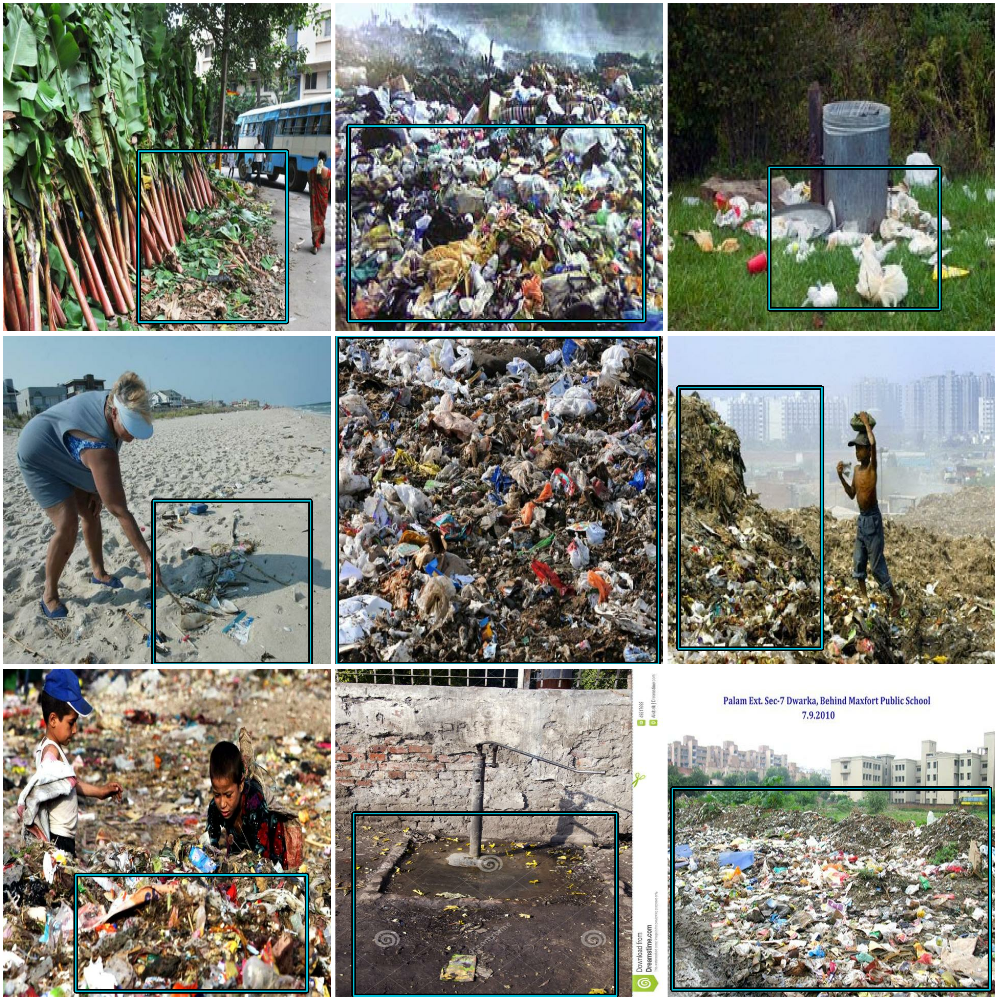

In [68]:
#@title visualize data

def visualize_dataset(inputs, value_range, rows, cols, bounding_box_format):
    inputs = next(iter(inputs.take(1)))
    images, bounding_boxes = inputs["images"], inputs["bounding_boxes"]
    visualization.plot_bounding_box_gallery(
        # images.to_tensor(),
        images,
        value_range=value_range,
        rows=rows,
        cols=cols,
        y_true=bounding_boxes,
        scale=10,
        font_scale=0.7,
        bounding_box_format=bounding_box_format,
        # class_mapping=class_mapping,
    )

visualize_dataset(
    train_ds,
    value_range=(0, 255),
    rows=3,
    cols=3,
    bounding_box_format='center_xywh'
)

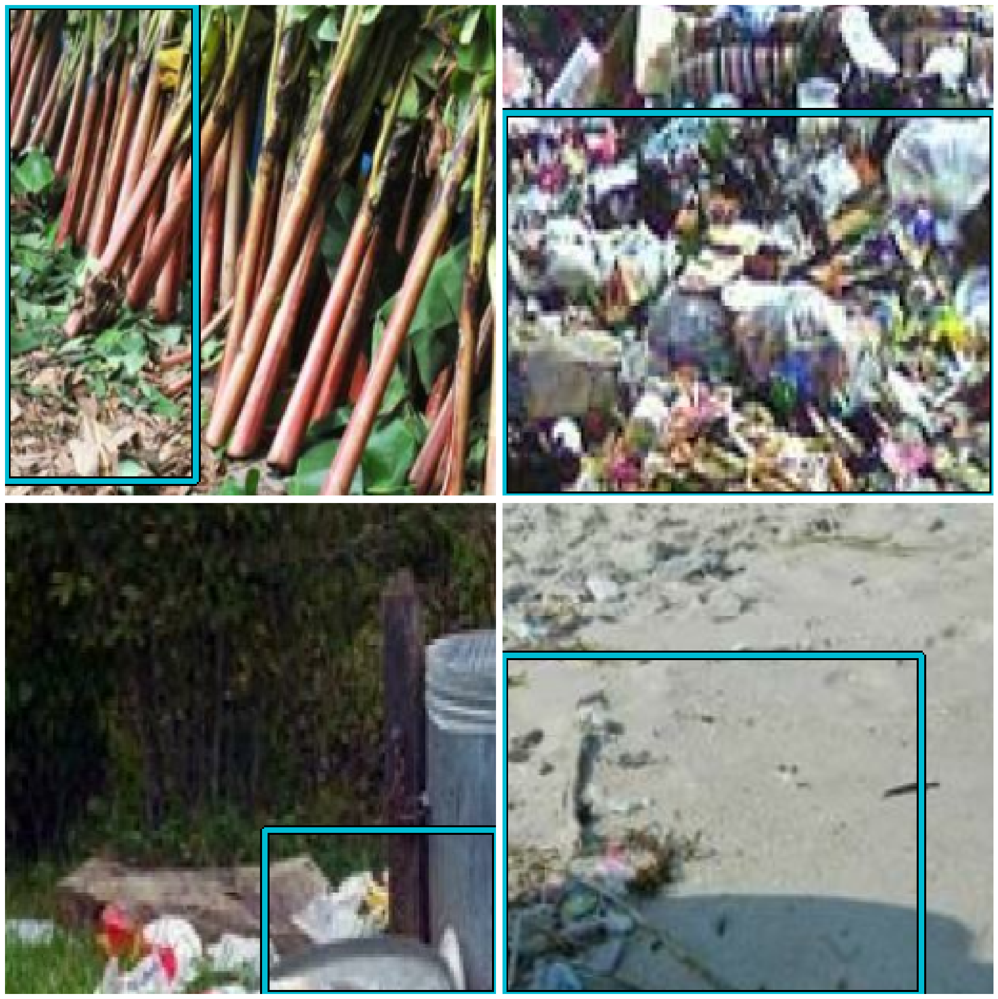

In [69]:
#@title Augmentetion pipeline
augmenters = [
    keras_cv.layers.RandomFlip(mode="horizontal", bounding_box_format=bounding_box_format),
    keras_cv.layers.JitteredResize(
        target_size=(256, 256), scale_factor=(0.75, 1.3), bounding_box_format=bounding_box_format
    ),
]


def create_augmenter_fn(augmenters):
    def augmenter_fn(inputs):
        for augmenter in augmenters:
            inputs = augmenter(inputs)
        return inputs

    return augmenter_fn


augmenter_fn = create_augmenter_fn(augmenters)

train_ds = train_ds.map(augmenter_fn)
visualize_dataset(
    train_ds, bounding_box_format=bounding_box_format, value_range=(0, 255), rows=2, cols=2
)

In [70]:
#@title Resizing TESTING data } we have already resized the TRAINING data while augmenting itself

# we have already resized the TRAINING data while augmentating itself.
inference_resizing = keras_cv.layers.Resizing(
    640, 640, bounding_box_format=bounding_box_format, pad_to_aspect_ratio=True
)
test_ds = test_ds.map(inference_resizing, num_parallel_calls=tf_data.AUTOTUNE)

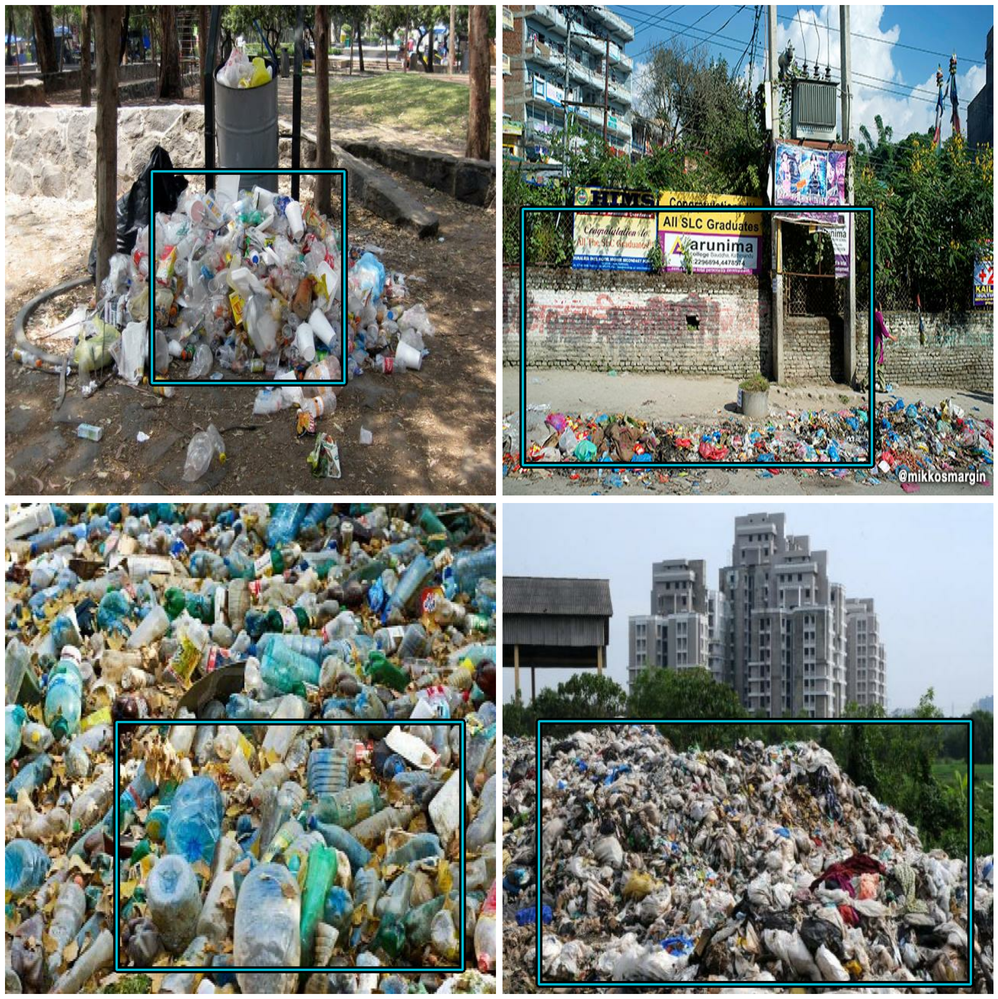

In [71]:
#@title visualizing TEST data

visualize_dataset(
    test_ds, bounding_box_format=bounding_box_format, value_range=(0, 255), rows=2, cols=2
)

In [72]:
def dict_to_tuple(inputs):
    return inputs["images"], keras_cv.bounding_box.to_dense(
        inputs["bounding_boxes"], max_boxes=32
    )


train_ds = train_ds.map(dict_to_tuple, num_parallel_calls=tf_data.AUTOTUNE)
test_ds = test_ds.map(dict_to_tuple, num_parallel_calls=tf_data.AUTOTUNE)

train_ds = train_ds.prefetch(tf_data.AUTOTUNE)
test_ds = test_ds.prefetch(tf_data.AUTOTUNE)

In [73]:
base_lr = 0.005
# including a global_clipnorm is extremely important in object detection tasks
optimizer = keras.optimizers.SGD(
    learning_rate=base_lr, momentum=0.9, global_clipnorm=10.0
)

In [74]:
coco_metrics_callback = keras_cv.callbacks.PyCOCOCallback(
    test_ds.take(20), bounding_box_format=bounding_box_format
)

In [75]:
#@title model creation

model = keras_cv.models.YOLOV8Detector.from_preset(
    "efficientnetv2_b0_imagenet",
    # For more info on supported bounding box formats, visit
    # https://keras.io/api/keras_cv/bounding_box/
    bounding_box_format=bounding_box_format,
    num_classes=20,
)

In [76]:
model.compile(
    classification_loss="binary_crossentropy",
    box_loss="ciou",
    optimizer=optimizer,
)

In [77]:
model.evaluate(test_ds)

3/3 ━━━━━━━━━━━━━━━━━━━━ 251s 80s/step - box_loss: 2.5989 - class_loss: 508.9643 - loss: 511.5632


[520.4476318359375, 2.6713995933532715, 517.7761840820312]

In [78]:
now_list=[]
if True:
  model.fit(
      train_ds.take(1),
      # Run for 10-35~ epochs to achieve good scores.
      epochs=30,
      callbacks=[coco_metrics_callback],
  )
  now = datetime.datetime.now()
  now_list.append(now)
  model.save(f'/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/localization/yolov8detector_efficientnetv2b0imagenet{now}.keras')

Epoch 1/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 186s 55s/step
creating index...
index created!
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.02s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU

# Inference and plotting results

In [79]:
model_path = f'/content/drive/MyDrive/DLCV project/Smart Waste Management in Modern Cities/localization/yolov8detector_efficientnetv2b0imagenet{now}.keras'
trained_model = keras.models.load_model(model_path)
# compiling trained_model as compile configrations are custom
trained_model.compile(
    classification_loss="binary_crossentropy",
    box_loss="ciou",
    optimizer=optimizer,
    # loss=keras_cv.losses.IoULoss()
)

/usr/local/lib/python3.10/dist-packages/keras/src/saving/serialization_lib.py:734: UserWarning: `compile()` was not called as part of model loading because the model's `compile()` method is custom. All subclassed Models that have `compile()` overridden should also override `get_compile_config()` and `compile_from_config(config)`. Alternatively, you can call `compile()` manually after loading.
  instance.compile_from_config(compile_config)


In [ ]:
#@title evaluating model
# evaluating model
trained_model.evaluate(test_ds)

      2/Unknown 137s 69s/step - box_loss: 2.5102 - class_loss: 82.8302 - loss: 85.3404

In [ ]:
visualization_ds = test_ds.unbatch()
visualization_ds = visualization_ds.ragged_batch(16)
visualization_ds = visualization_ds.shuffle(8)

In [ ]:
def visualize_detections(model, dataset, bounding_box_format):
    images, y_true = next(iter(dataset.take(1)))
    y_pred = model.predict(images)
    visualization.plot_bounding_box_gallery(
        images,
        value_range=(0, 255),
        bounding_box_format=bounding_box_format,
        y_true=y_true,
        y_pred=y_pred,
        scale=4,
        rows=2,
        cols=2,
        show=True,
        font_scale=0.7,
        class_mapping=class_mapping,
    )

1/1 ━━━━━━━━━━━━━━━━━━━━ 76s 76s/step


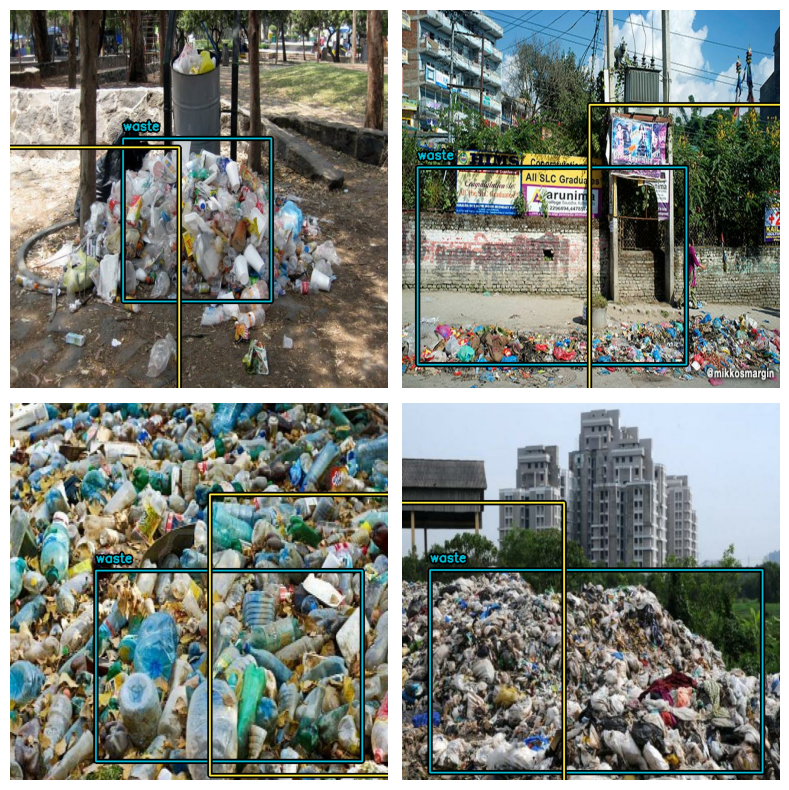

In [83]:
trained_model.prediction_decoder = keras_cv.layers.NonMaxSuppression(
    bounding_box_format=bounding_box_format,
    from_logits=True,
    iou_threshold=0.5,
    confidence_threshold=0.5,      # 0.75
    # max_detections_per_class=1,
    max_detections=1,
)

visualize_detections(trained_model, dataset=test_ds, bounding_box_format=bounding_box_format)